# <a id='toc1_'></a>[Realtime Inference with SDXL 1.0](#toc0_)
### For AWS Bedrock event 10/10

This sample notebook showcases some functionality of Stability's SDXL.

 [Stability SDK documentation](https://api.stability.ai/docs#tag/v1generation)

  
- [1. Set up your Credentials](#toc3_)    
- [2: Perform real-time inference](#toc4_)    
  - [A: Text to image](#toc4_1_) 
  - [B: Render text](#toc4_3_)  
  - [C: Image to image](#toc4_4_) 
  - [D: Image to image](#toc4_5_)    



This notebook uses the Stability REST API to generate images

First: 
```
$ git clone git@github.com:Stability-AI/demos.git
$ cd demos
```



In [48]:
!pip install requests

import base64
import os
import io
import requests
from PIL import Image

engine_id = "stable-diffusion-xl-1024-v1-0"
api_host = "https://staging-api.stability.ai"   # We will use the staging API for this demo. The production API omits 'staging-' from the host name
api_key = ""   # Supplied for hands-on workshops


[notice] A new release of pip is available: 23.0.1 -> 23.2.1
[notice] To update, run: pip install --upgrade pip


# <a id='toc4_'></a> Perform realtime inference with SDXL

## <a id='toc4_1_'></a>[A: Text to image](#toc0_)

We'll start by running a generation request. For the full list of parameters, [see the Stability.ai SDK documentation.](https://api.stability.ai/docs#tag/v1generation)



In [49]:
response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/text-to-image",
    headers={
        "Content-Type": "application/json",
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    json={
    "text_prompts": [
        {
            "text": "jaguar in the Amazon rainforest"
        }
    ],
        "seed": 12345,

    },
)

Output images are included in the response's `artifacts` as base64 encoded strings. Below is a helper function for accessing decoding these images:

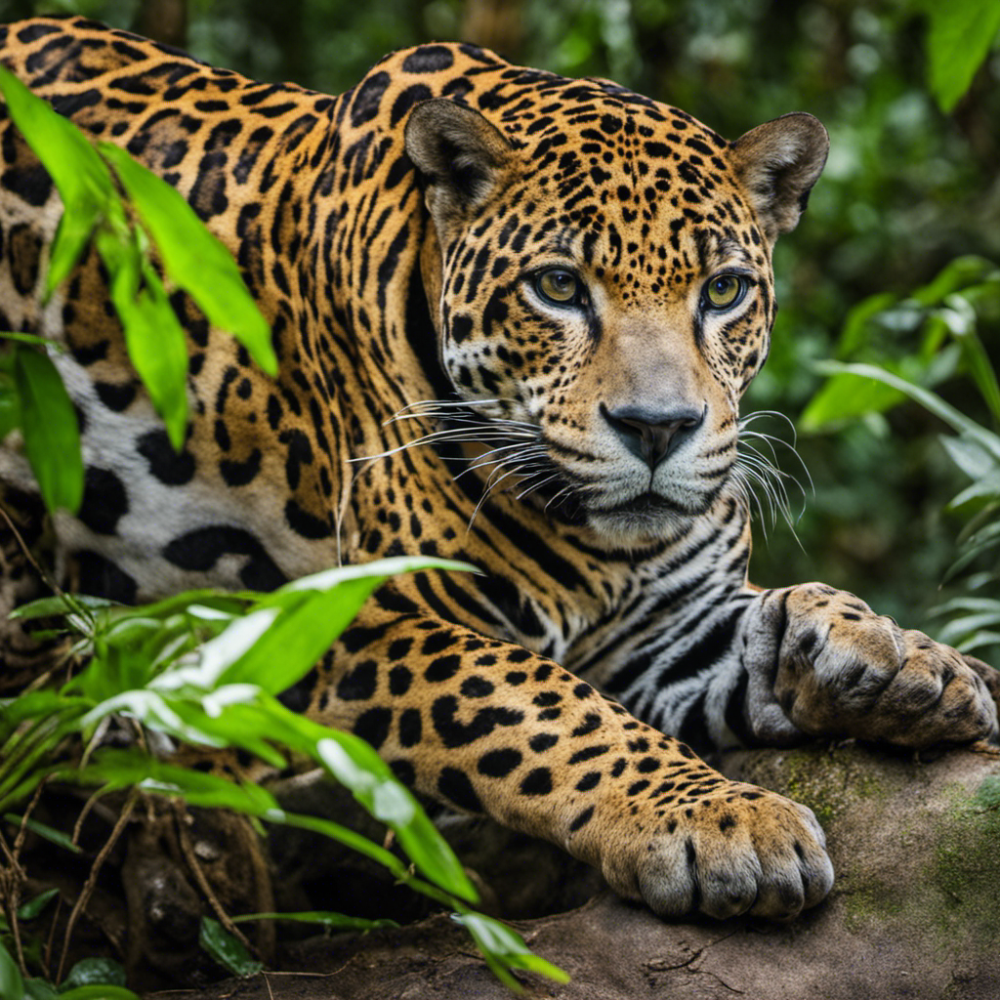

In [50]:
def decode_and_show(model_response: requests.models.Response) -> None:
    """
    Decodes and displays an image from SDXL output

    Args:
        model_response (GenerationResponse): The response object from the deployed SDXL model.

    Returns:
        None
    """
    # image = model_response.artifacts[0].base64
    data = model_response.json()
    for i, image in enumerate(data["artifacts"]):
        image_data = base64.b64decode(image["base64"])
        image = Image.open(io.BytesIO(image_data))
        display(image)

decode_and_show(response)



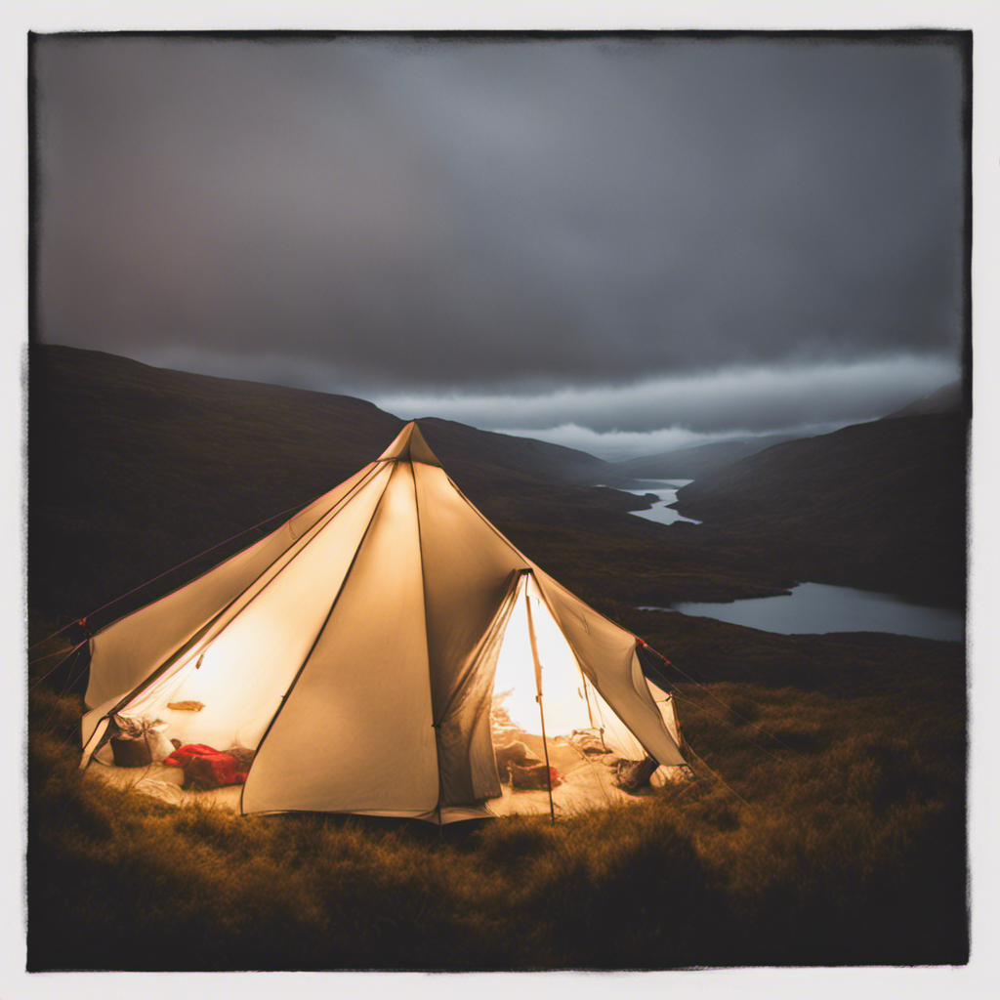

In [51]:
response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/text-to-image",
    headers={
        "Content-Type": "application/json",
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    json={
    "text_prompts": [
        {
            "text": "cosy photograph, taken from inside of a tent with view of misty Scottish highlands at dawn"
        }
    ],
        "seed": 12345,

    },
)

decode_and_show(response)

Now let's experiment with a different image resolution. SDXL supports a fixed set of resolutions, that include formats suitable for webpage banners, portraits and other assets.

The requested (height, width) should be one of (1024, 1024), (1152, 896), (896, 1152), (1216, 832), (832, 1216), (1344, 768), (768, 1344), (1536, 640), (640, 1536).

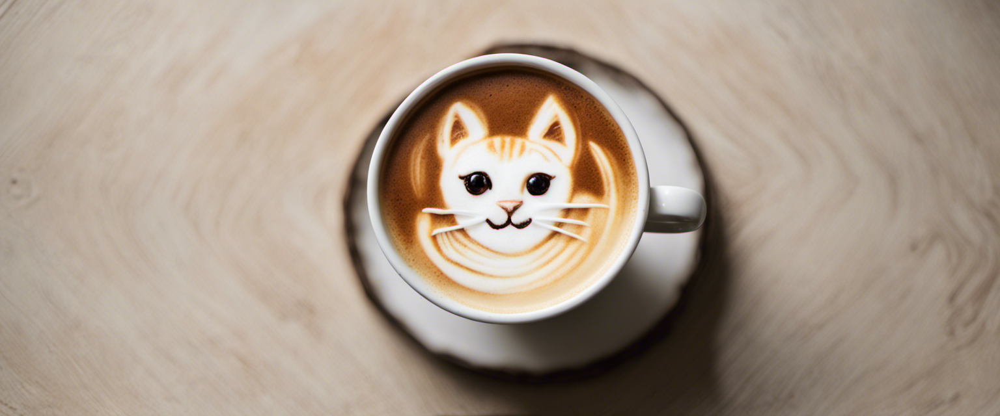

In [52]:
text = "photograph of latte art of a cat"

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/text-to-image",
    headers={
        "Content-Type": "application/json",
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    json={
    "text_prompts": [
        {
            "text": text
        }
    ],
        "seed": 5,
        "height": 640,
        "width": 1536

    },
)

decode_and_show(response)

## <a id='toc4_3_'></a>[B: Render Text](#toc0_)


SDXL can render short snippets of text, like single words. Let's try an example below.

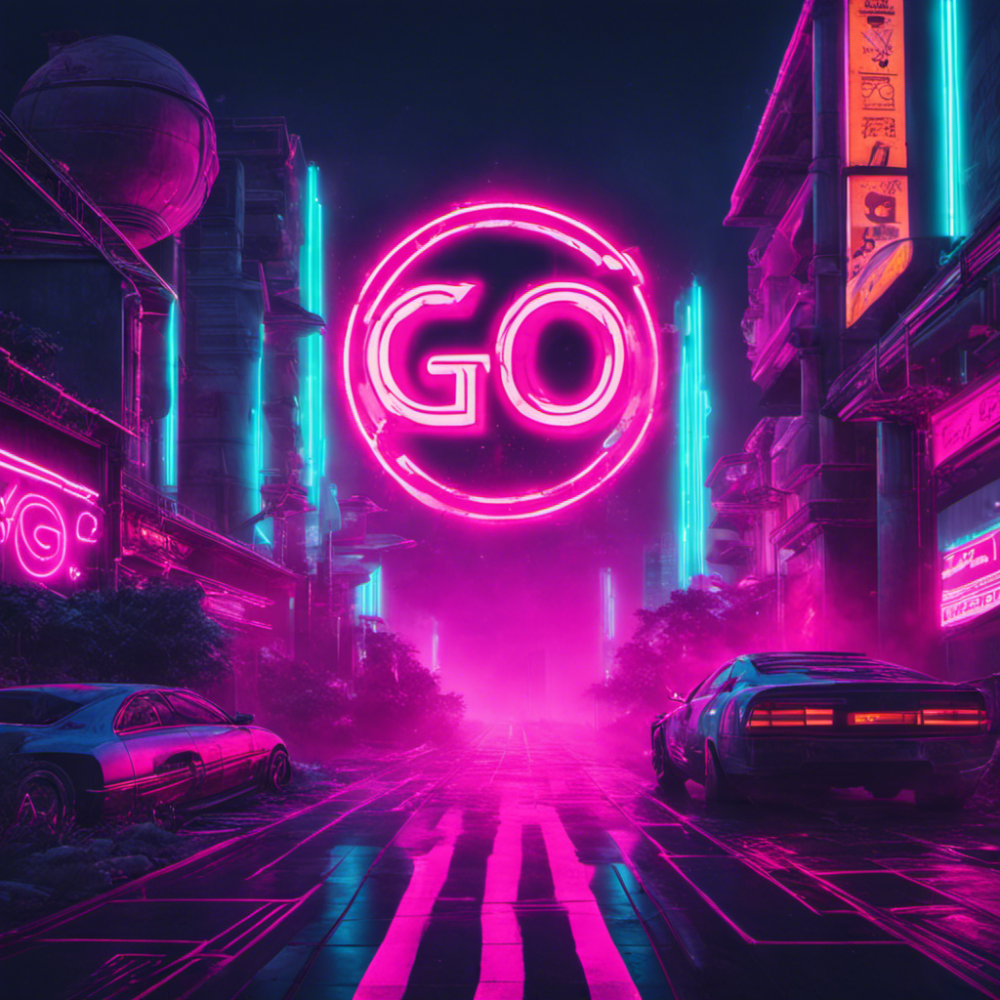

In [53]:
text = "a sign that says go"

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/text-to-image",
    headers={
        "Content-Type": "application/json",
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    json={
    "text_prompts": [
        {
            "text": text
        }
    ],
        "seed": 191,
        "style_preset": "neon-punk",
        "cfg_scale": 10

    },
)

decode_and_show(response)

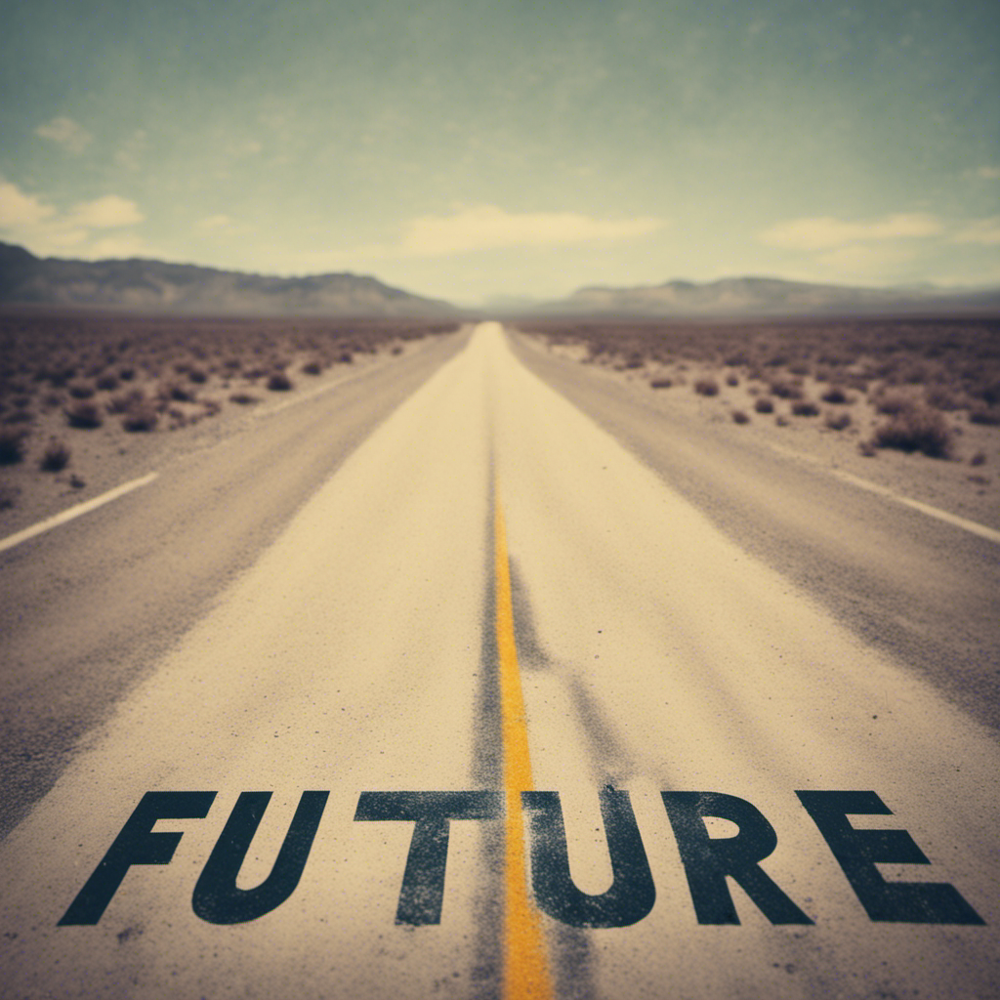

In [54]:
text = "Polaroid photo. A dusty roadsign that says FUTURE with an arrow"

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/text-to-image",
    headers={
        "Content-Type": "application/json",
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    json={
    "text_prompts": [
        {
            "text": text
        }
    ],
        "seed": 17,
        "style_preset": "cinematic",
        "cfg_scale": 10

    },
)
decode_and_show(response)

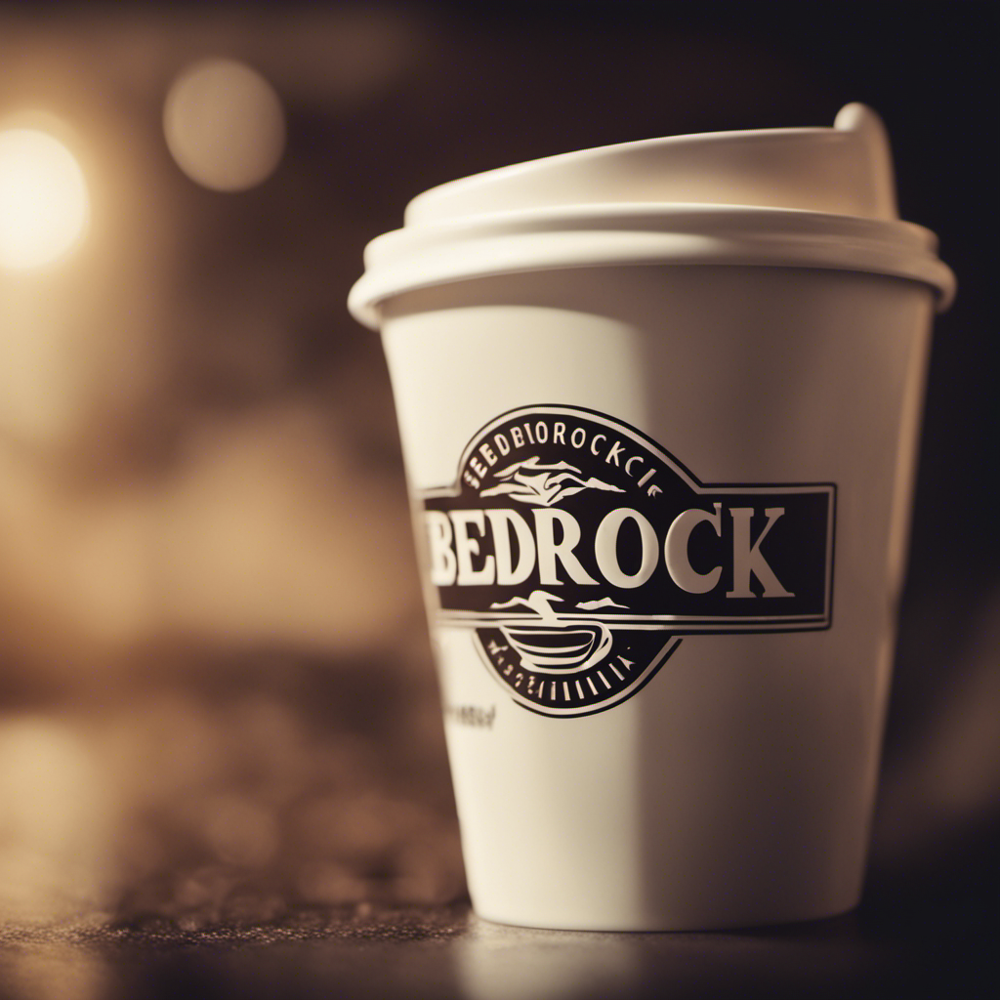

In [55]:
text = "a coffee cup with a logo and the word 'bedrock'"

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/text-to-image",
    headers={
        "Content-Type": "application/json",
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    json={
    "text_prompts": [
        {
            "text": text
        }
    ],
        "seed": 11,
        "style_preset": "cinematic",
        "cfg_scale": 10

    },
)


decode_and_show(response)

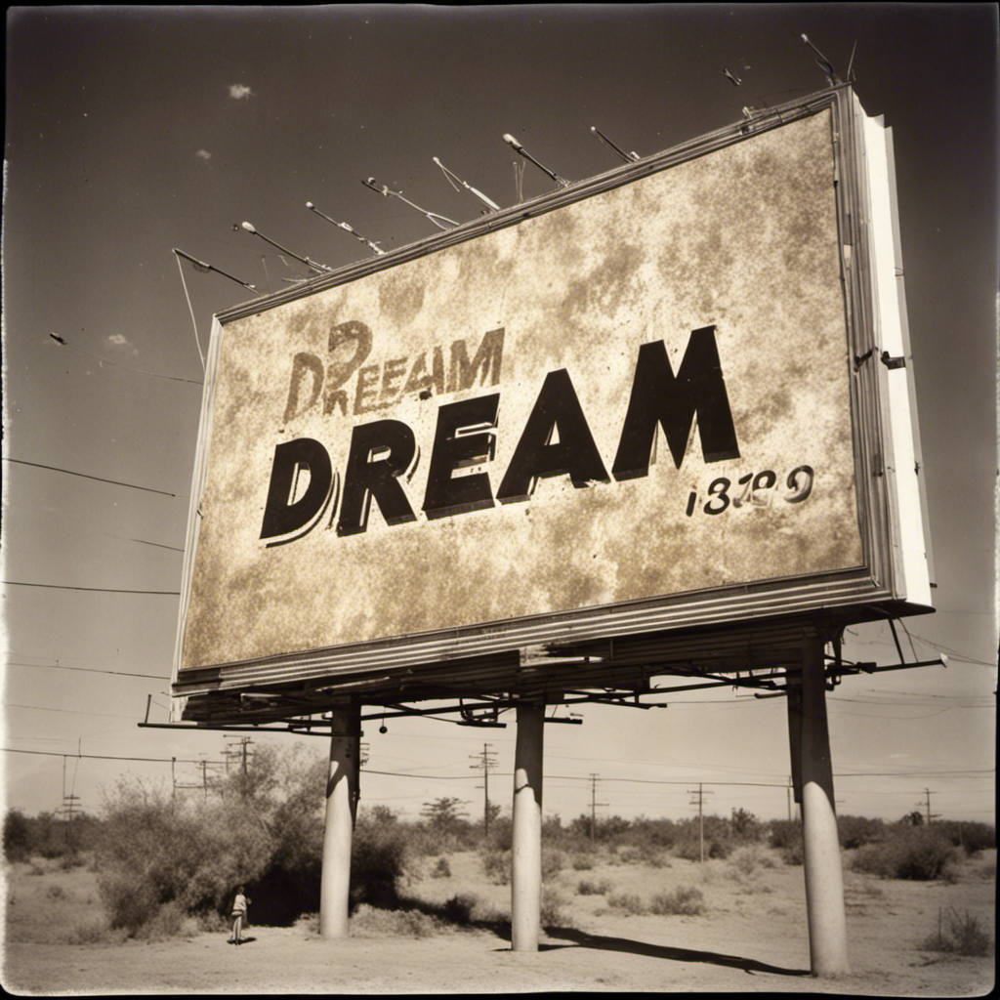

In [56]:
text = "a 1950s billboard that says DREAM"

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/text-to-image",
    headers={
        "Content-Type": "application/json",
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    json={
    "text_prompts": [
        {
            "text": text
        }
    ],
        "seed": 11,
        "height": 1024,
        "width": 1024,
        "style_preset": "analog-film",
        "cfg_scale": 10

    },
)


decode_and_show(response)

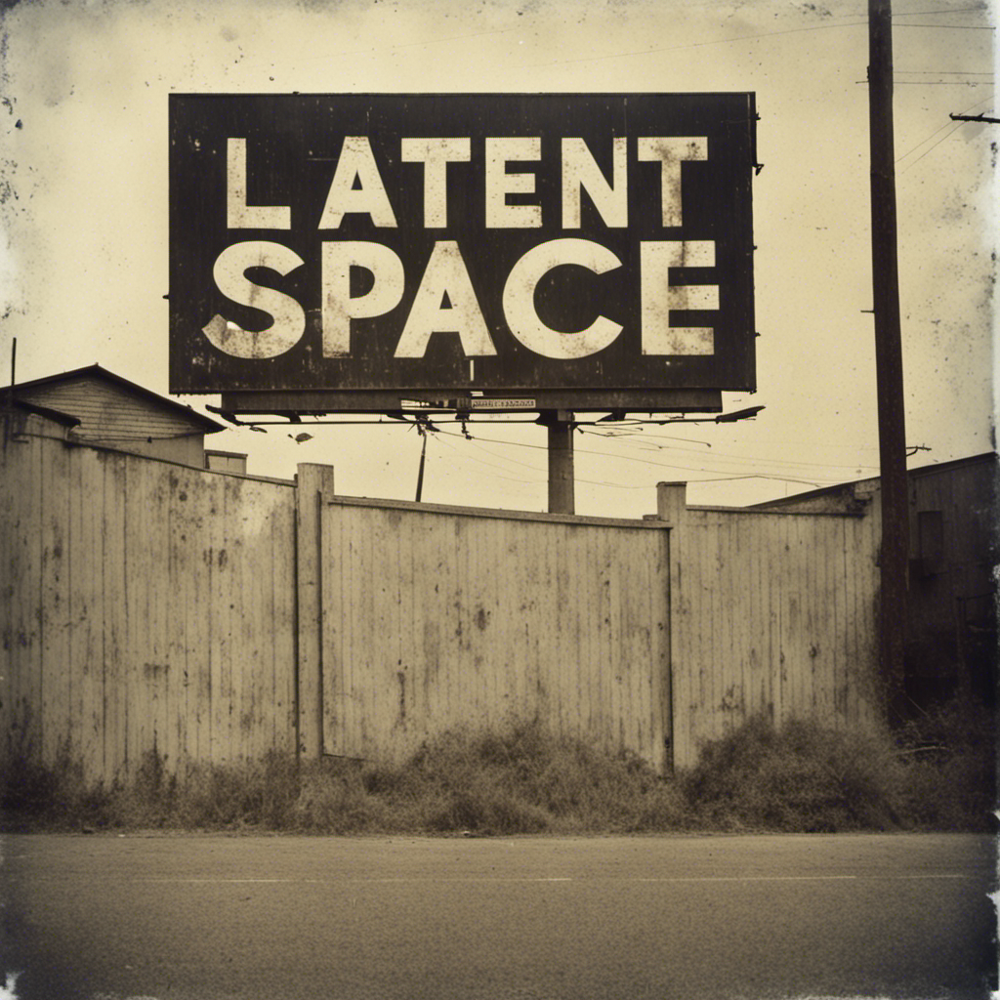

In [57]:
text = "'latent space' is written on a 1950s billboard"

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/text-to-image",
    headers={
        "Content-Type": "application/json",
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    json={
    "text_prompts": [
        {
            "text": text
        }
    ],
        "seed": 76532,
        "height": 1024,
        "width": 1024,
        "style_preset": "analog-film",
        "cfg_scale": 10

    },
)


decode_and_show(response)

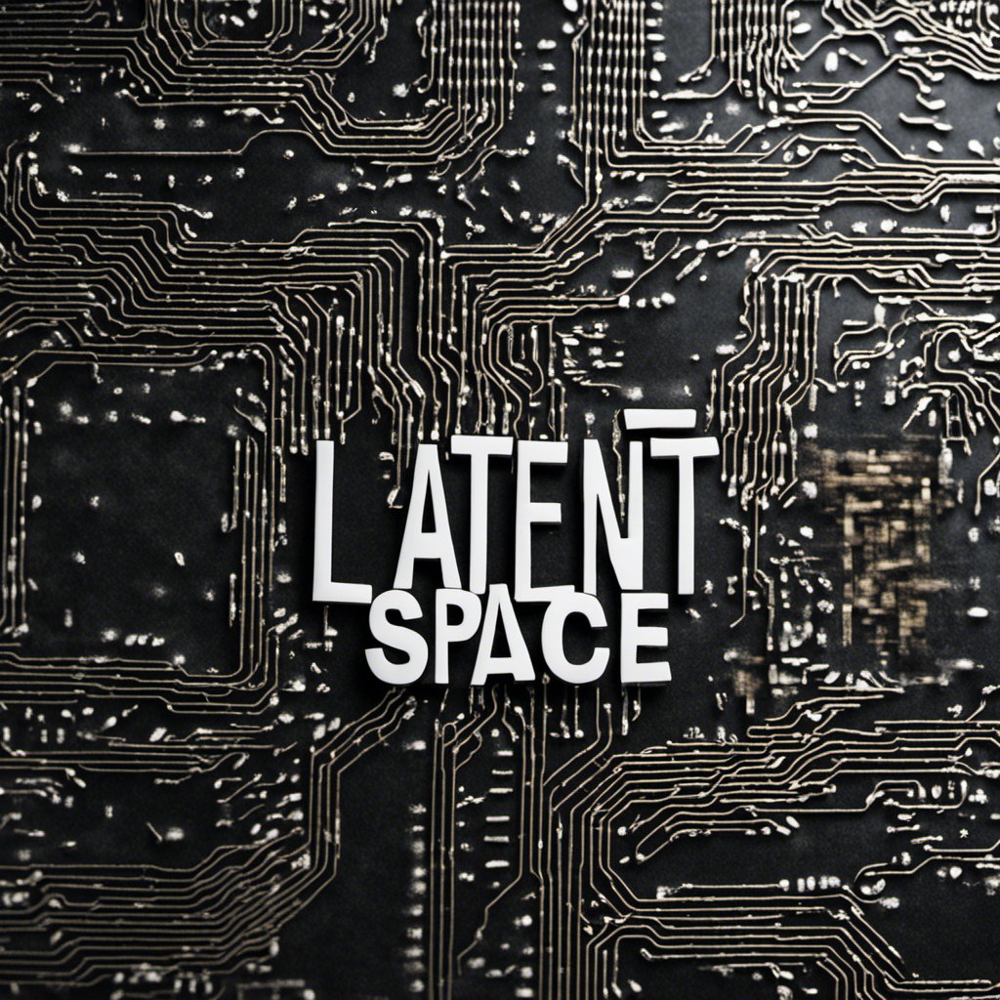

In [58]:
text = "the words'latent space' written on computer chip "

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/text-to-image",
    headers={
        "Content-Type": "application/json",
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    json={
    "text_prompts": [
        {
            "text": text
        }
    ],
        "seed": 6455466,
        "cfg_scale": 10

    },
)


decode_and_show(response)

## <a id='toc4_4_'></a>[C: Image to image](#toc0_)

To perform inference that takes an image as input, you must pass the image into `init_image`.

For the REST API, images don't need to be encoded: just submit the file.

Like output images, input images must be one of the supported resolutions: i.e. (height, width) should be one of (1024, 1024), (1152, 896), (896, 1152), (1216, 832), (832, 1216), (1344, 768), (768, 1344), (1536, 640), (640, 1536).

We set `image_strength` to weight the relative importance of the image and the prompt. For the demo, we'll use a [picture of the cat, taken from Wikimedia Commons](https://commons.wikimedia.org/wiki/File:Cat_August_2010-4.jpg), provided along with this notebook.

In [59]:
! wget https://platform.stability.ai/Cat_August_2010-4.jpg

--2023-10-10 10:43:49--  https://platform.stability.ai/Cat_August_2010-4.jpg
Resolving platform.stability.ai (platform.stability.ai)... 172.64.153.32, 104.18.34.224, 2606:4700:4400::6812:22e0, ...
Connecting to platform.stability.ai (platform.stability.ai)|172.64.153.32|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 28624 (28K) [image/jpeg]
Saving to: ‘Cat_August_2010-4.jpg.9’

Cat_August_2010-4.j 100%[===================>]  27.95K  --.-KB/s    in 0s      

2023-10-10 10:43:50 (66.2 MB/s) - ‘Cat_August_2010-4.jpg.9’ saved [28624/28624]



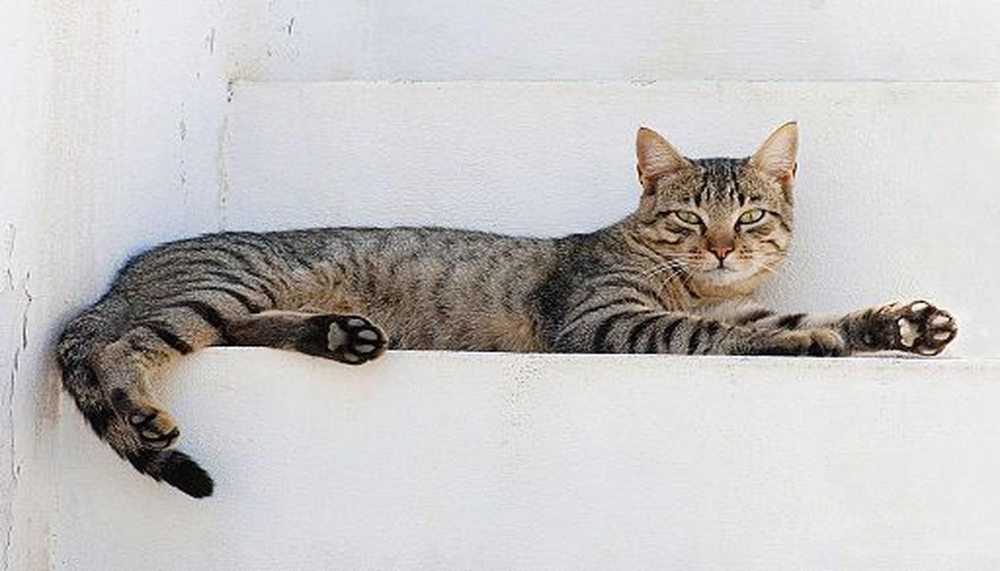

In [60]:
# We will resize this image via cropping, so that it meets the model's requirements on resolution.

im = Image.open('Cat_August_2010-4.jpg')
im1 = im.resize((1344, 768), Image.Resampling.LANCZOS)
im1.save("cat_resized.jpg")

im1

The `image_strength` parameter is a float that determines the relative weighting of the image prompt against the text prompt.

For image-to-image generation, try turning the `image_strength` up. In the example below, compare `image_strength`s 0.3 and 0.9.

At 0.9, the image has lost the sense of 'embroidery', and renders an image that is very close to the input image. 0.7 gives a better balance.

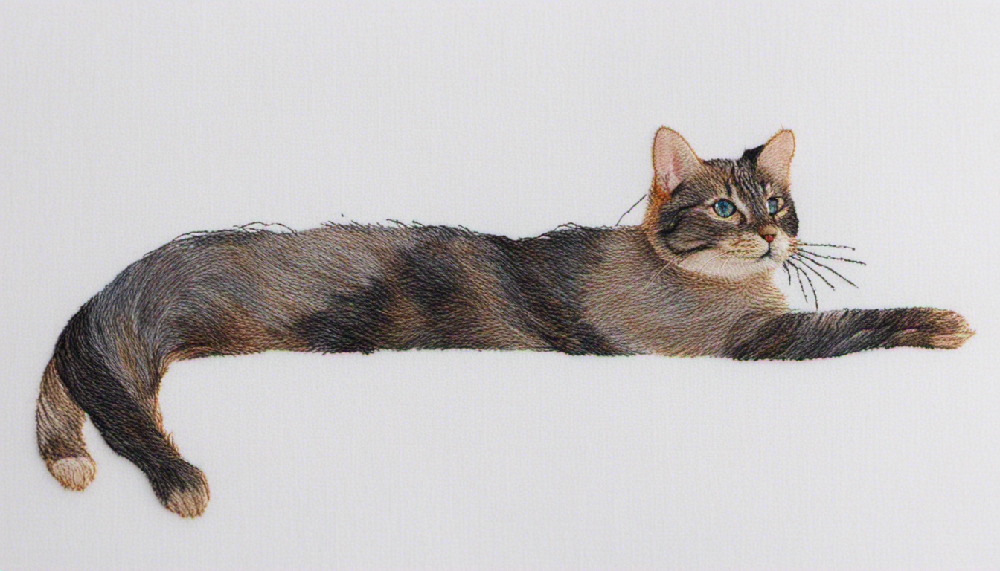

In [61]:
cat_path = "cat_resized.jpg"

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/image-to-image",  # Note that the engine-id has changed
    headers={
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    files={
        "init_image": open(cat_path, "rb")
    },
    data={
        "image_strength": 0.35,
        "text_prompts[0][text]": "embroidery of a cat",
        "cfg_scale": 7,
        "steps": 30,
        "seed": 44
    }
)

decode_and_show(response)

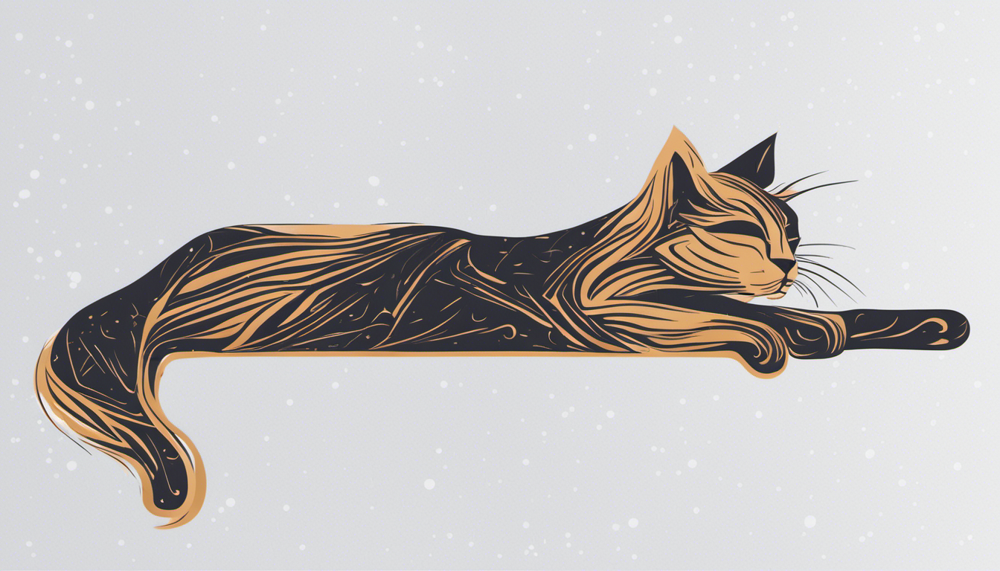

In [62]:

cat_path = "cat_resized.jpg"

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/image-to-image",  # Note that the engine-id has changed
    headers={
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    files={
        "init_image": open(cat_path, "rb")
    },
    data={
        "image_strength": 0.25,
        "init_image_mode": "IMAGE_STRENGTH",
        "text_prompts[0][text]": "flat vector graphic logo of a cat",
        "cfg_scale": 7,
        "steps": 30,
        "seed": 44
    }
)

decode_and_show(response)

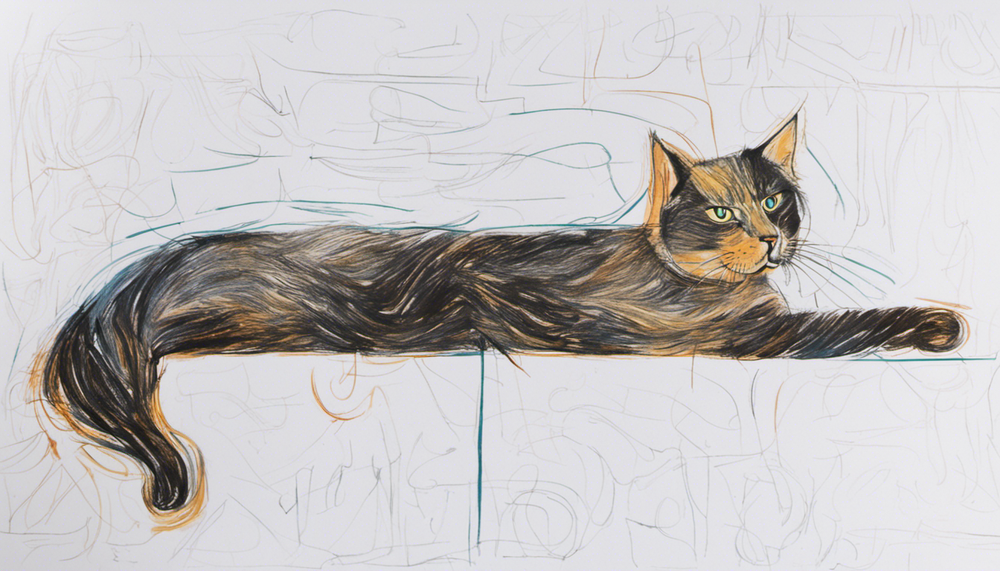

In [63]:
cat_path = "cat_resized.jpg"

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/image-to-image",  # Note that the engine-id has changed
    headers={
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    files={
        "init_image": open(cat_path, "rb")
    },
    data={
        "image_strength": 0.35,
        "init_image_mode": "IMAGE_STRENGTH",
        "text_prompts[0][text]": "picasso line drawing of a cat, brushstrokes",
        "cfg_scale": 7,
        "steps": 30,
        "seed": 44
    }
)

decode_and_show(response)

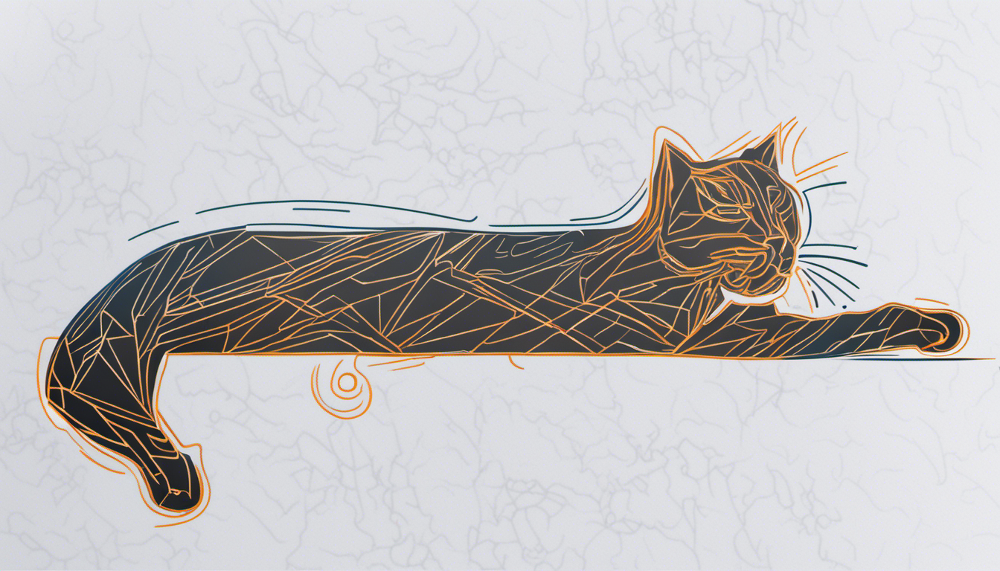

In [64]:
cat_path = "cat_resized.jpg"

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/image-to-image",  # Note that the engine-id has changed
    headers={
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    files={
        "init_image": open(cat_path, "rb")
    },
    data={
        "image_strength": 0.35,
        "init_image_mode": "IMAGE_STRENGTH",
        "text_prompts[0][text]": "logo of cat, continuous line, heavy outline",
        "cfg_scale": 12,
        "steps": 30,
        "seed": 44
    }
)

decode_and_show(response)

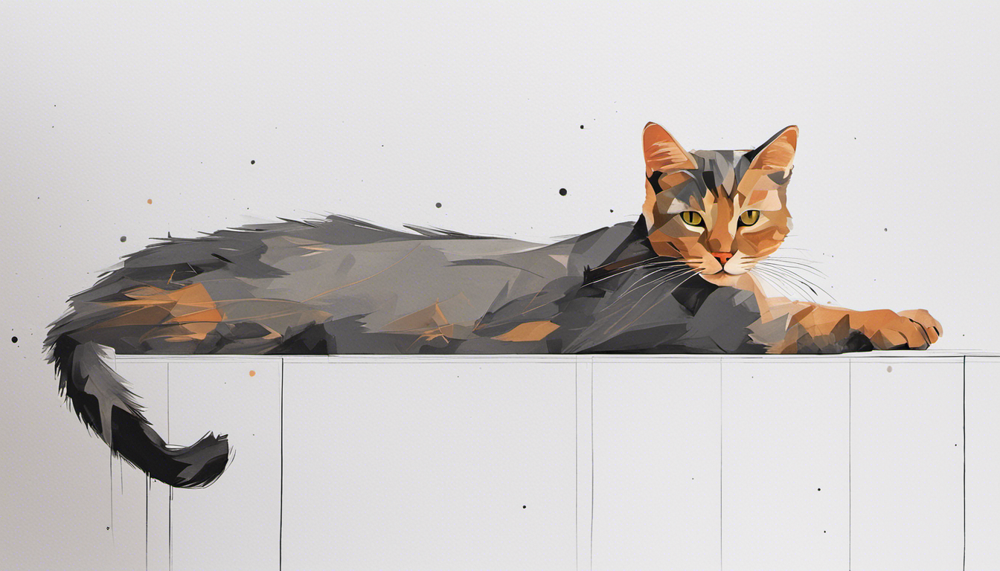

In [65]:
cat_path = "cat_resized.jpg"

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/image-to-image",  # Note that the engine-id has changed
    headers={
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    files={
        "init_image": open(cat_path, "rb")
    },
    data={
        "image_strength": 0.25,
        "init_image_mode": "IMAGE_STRENGTH",
        "text_prompts[0][text]": "minimalist, clean line, cat print",
        "cfg_scale": 12,
        "steps": 30,
        "seed": 1000
    }
)

decode_and_show(response)

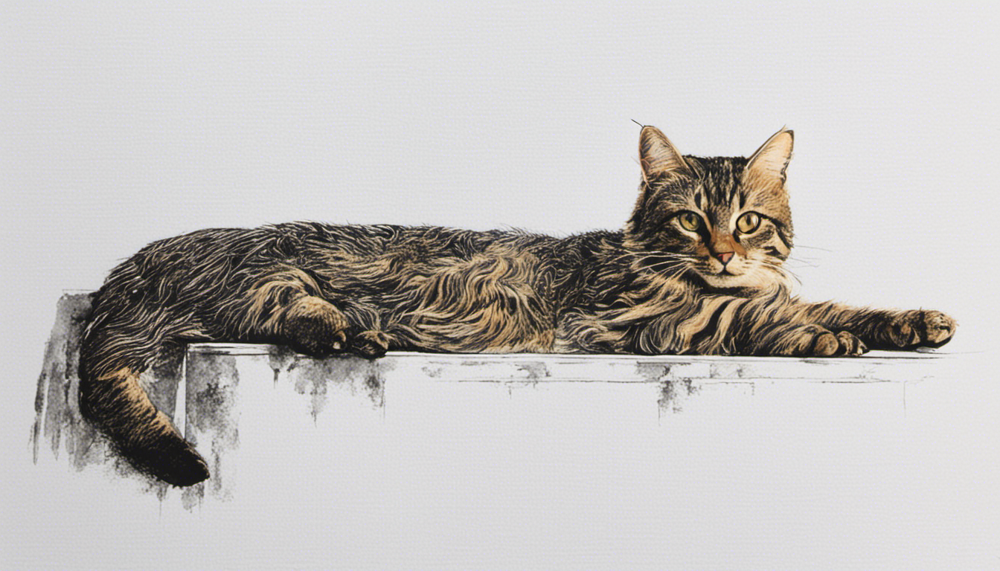

In [66]:
cat_path = "cat_resized.jpg"

response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/image-to-image",  # Note that the engine-id has changed
    headers={
        "Accept": "application/json",
        "Authorization": f"Bearer {api_key}"
    },
    files={
        "init_image": open(cat_path, "rb")
    },
    data={
        "image_strength": 0.35,
        "init_image_mode": "IMAGE_STRENGTH",
        "text_prompts[0][text]": "cat screen print",
        "cfg_scale": 7,
        "steps": 150,
        "seed": 10000
    }
)

decode_and_show(response)

## <a id='toc4_5_'></a>[D: Inpainting](#toc0_)

Inpainting is a powerful image-to-image technique that allows you to selectively edit and re-generate portions of an image.

Indicate the regions you want to update using masking.

Let's start with an image and mask off a section.

Here is a woman wearing a scarf. Let's update the colour and texture of the scarf.

--2023-10-10 10:45:52--  https://platform.stability.ai/scarf_input.jpg
Resolving platform.stability.ai (platform.stability.ai)... 104.18.34.224, 172.64.153.32, 2606:4700:4400::ac40:9920, ...
Connecting to platform.stability.ai (platform.stability.ai)|104.18.34.224|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 102043 (100K) [image/jpeg]
Saving to: ‘scarf_input.jpg.8’

scarf_input.jpg.8   100%[===================>]  99.65K  --.-KB/s    in 0.002s  

2023-10-10 10:45:52 (62.5 MB/s) - ‘scarf_input.jpg.8’ saved [102043/102043]



--2023-10-10 10:45:53--  https://platform.stability.ai/scarf_mask_only_bw.png
Resolving platform.stability.ai (platform.stability.ai)... 104.18.34.224, 172.64.153.32, 2606:4700:4400::ac40:9920, ...
Connecting to platform.stability.ai (platform.stability.ai)|104.18.34.224|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 12229 (12K) [image/png]
Saving to: ‘scarf_mask_only_bw.png.8’

scarf_mask_only_bw. 100%[===================>]  11.94K  --.-KB/s    in 0s      

2023-10-10 10:45:53 (54.6 MB/s) - ‘scarf_mask_only_bw.png.8’ saved [12229/12229]



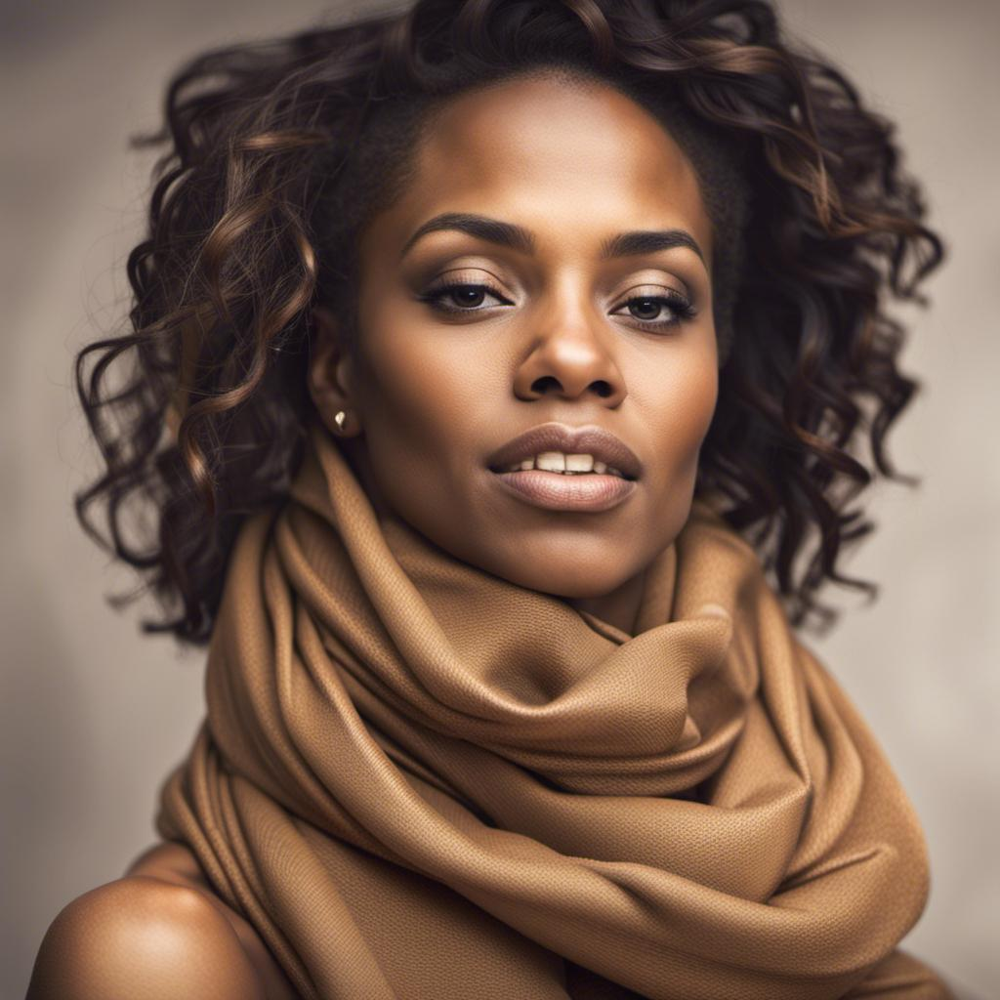

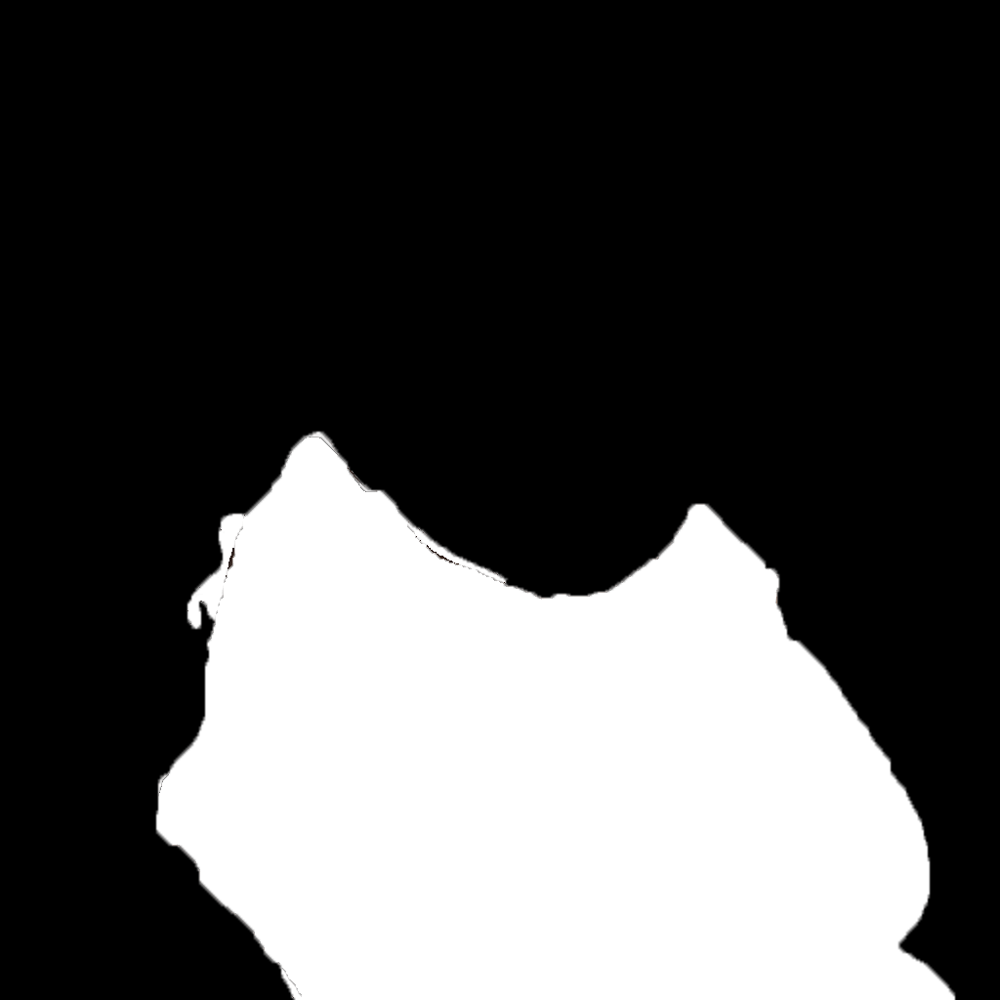

In [67]:
! wget https://platform.stability.ai/scarf_input.jpg
! wget https://platform.stability.ai/scarf_mask_only_bw.png

display(Image.open('scarf_input.jpg'))
display(Image.open('scarf_mask_only_bw.png').convert('RGB'))

To perform inpainting, you submit two input images: the image to be updated, and the mask indicating the areas to revise.

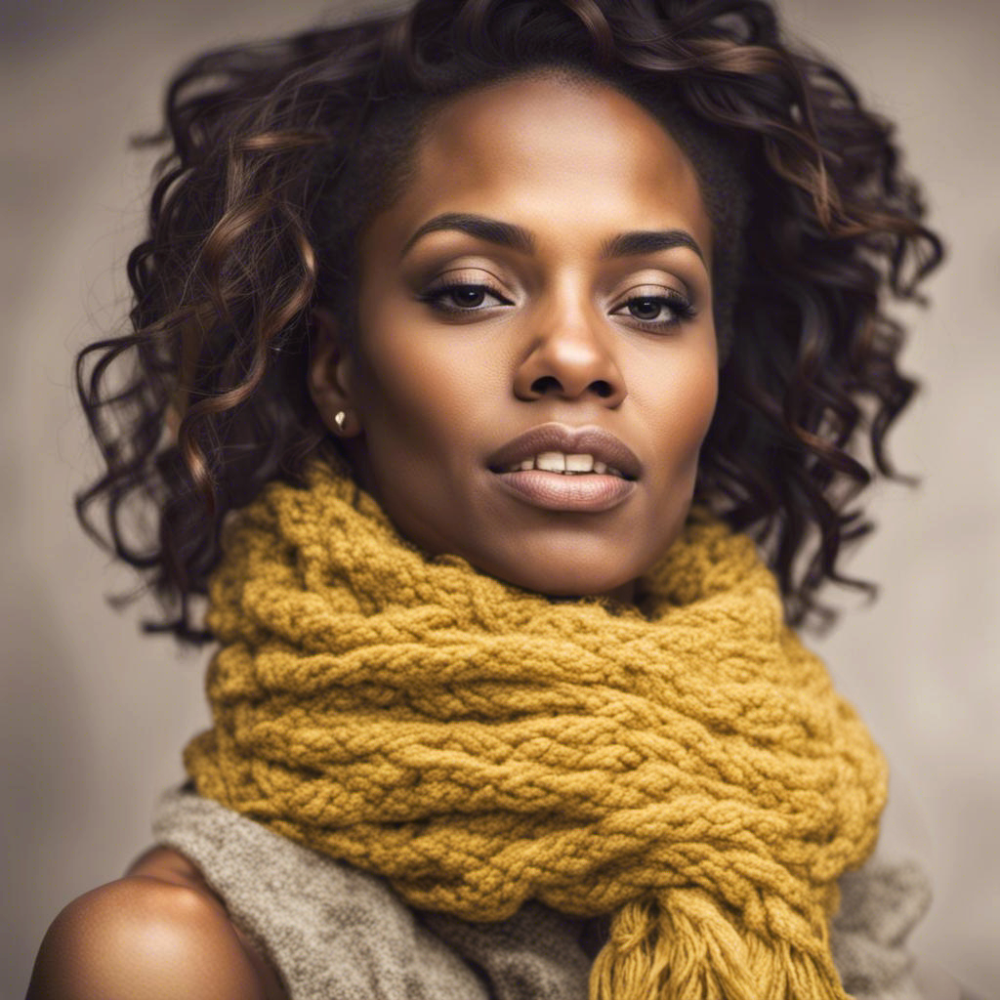

In [68]:
response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/image-to-image/masking",
    headers={
        "Accept": 'application/json',
        "Authorization": f"Bearer {api_key}"
    },
    files={
        "init_image": open("scarf_input.jpg", "rb"),
        "mask_image": open("scarf_mask_only_bw.png", "rb")
    },
    data={
        "mask_source": "MASK_IMAGE_WHITE",
        "text_prompts[0][text]": "A woman wearing a hand-knitted, yellow woolly scarf",
        "cfg_scale": 7,
        "samples": 1,
        "steps": 30,
        "seed": 81
    }
)

decode_and_show(response)

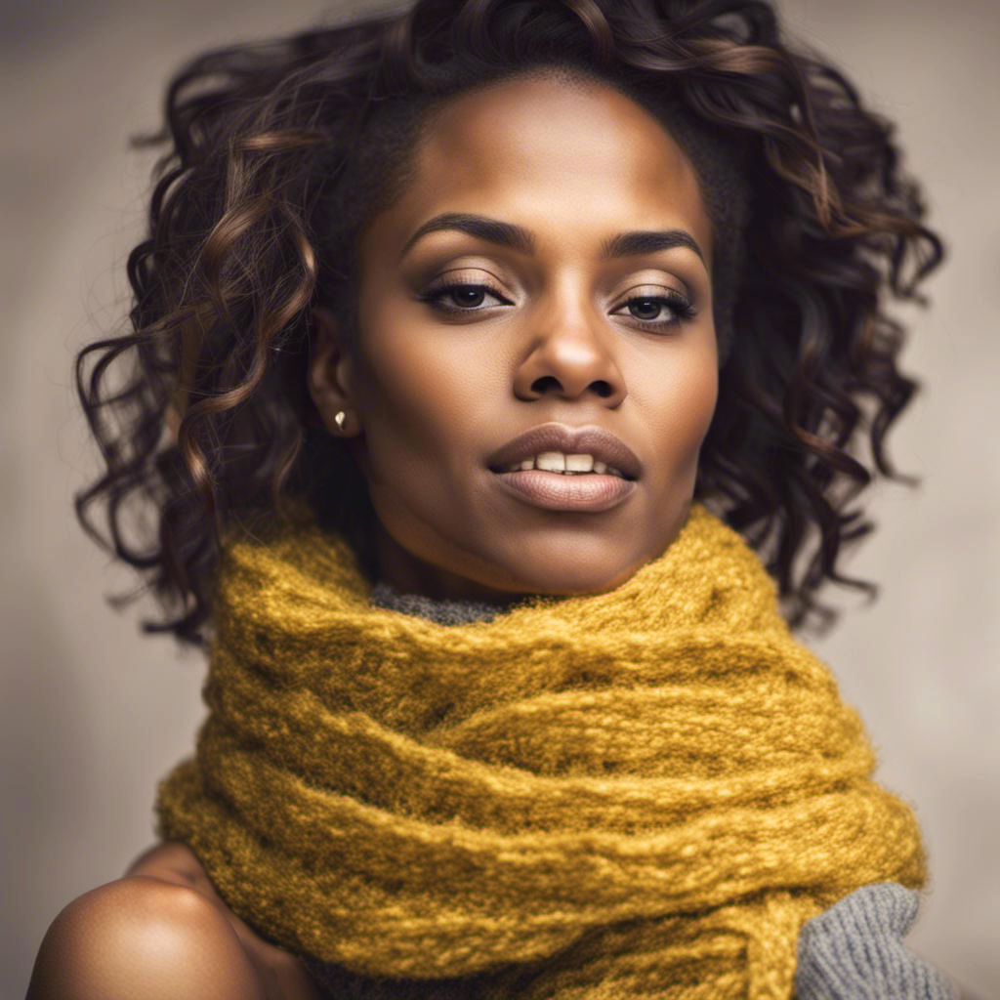

In [69]:
response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/image-to-image/masking",
    headers={
        "Accept": 'application/json',
        "Authorization": f"Bearer {api_key}"
    },
    files={
        "init_image": open("scarf_input.jpg", "rb"),
         "mask_image": open("scarf_mask_only_bw.png", "rb")
    },
    data={
        "mask_source": "MASK_IMAGE_WHITE",
        "text_prompts[0][text]": "A woman wearing a hand-knitted, yellow woolly scarf",
        "cfg_scale": 11,
        "samples": 1,
        "steps": 30,
        "seed": 8451
    }
)

decode_and_show(response)

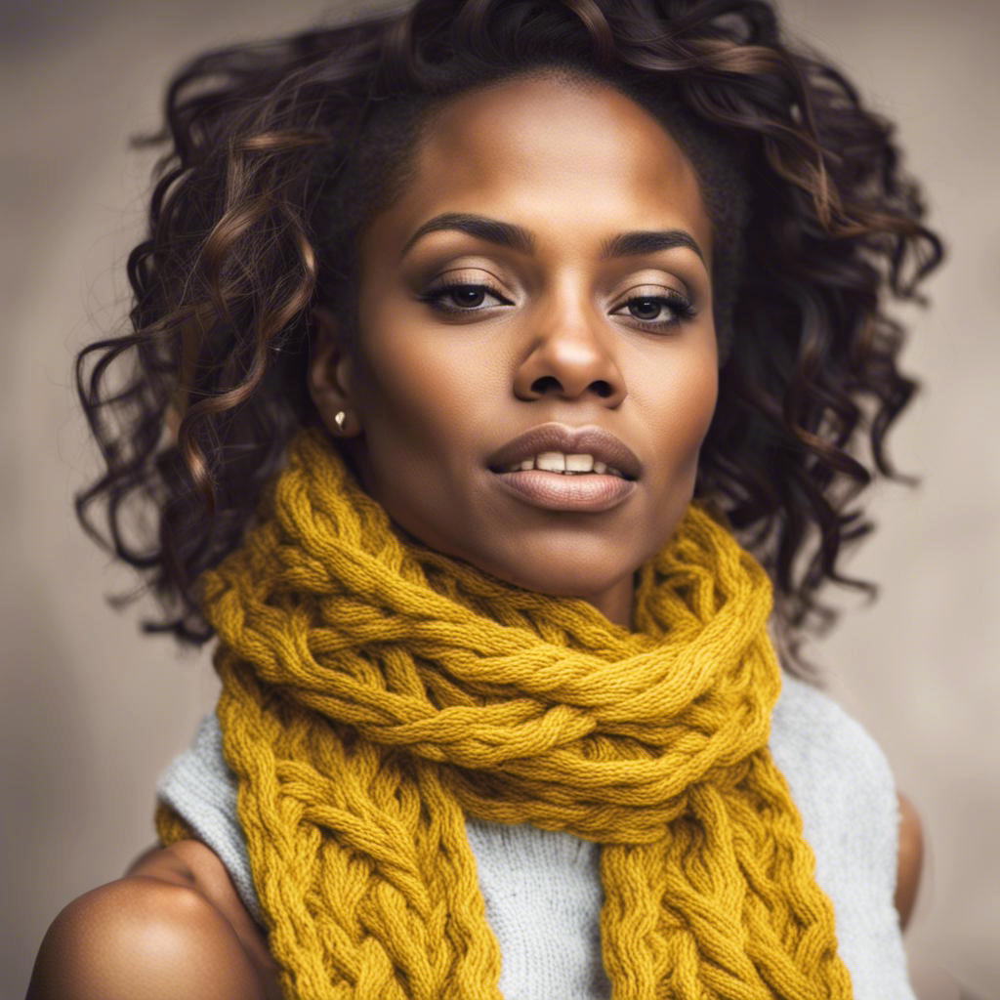

In [70]:
response = requests.post(
    f"{api_host}/v1/generation/{engine_id}/image-to-image/masking",
    headers={
        "Accept": 'application/json',
        "Authorization": f"Bearer {api_key}"
    },
    files={
        "init_image": open("scarf_input.jpg", "rb"),
         "mask_image": open("scarf_mask_only_bw.png", "rb")
    },
    data={
        "mask_source": "MASK_IMAGE_WHITE",
        "text_prompts[0][text]": "A woman wearing a hand-knitted, yellow cable-knit scarf",
        "cfg_scale": 11,
        "samples": 1,
        "steps": 30,
        "seed": 234
    }
)

decode_and_show(response)

# Next steps

Try the Stability API and Python SDK.

You can deploy SDXL in your own VPC using AWS Jumpstart: https://aws.amazon.com/blogs/machine-learning/use-stable-diffusion-xl-with-amazon-sagemaker-jumpstart-in-amazon-sagemaker-studio/

Use SDXL directly on AWS Bedrock.